# Python `croissant` formating of NOVEL-SS 🥐

## Load libraries

In [11]:
# # Install mlcroissant from the source
# !apt-get install -y python3-dev graphviz libgraphviz-dev pkg-config
# !pip install "git+https://github.com/${GITHUB_REPOSITORY:-mlcommons/croissant}.git@${GITHUB_HEAD_REF:-main}#subdirectory=python/mlcroissant&egg=mlcroissant[dev]"

# Needed imports in the notebook:
import io
import os
import json

import ast
from etils import epath
from IPython.display import display
import mlcroissant as mlc
from PIL import Image
from PIL import ImageDraw
import requests

# abspath = os.path.abspath(__file__)
# dname = os.path.dirname(abspath)
# os.chdir(dname)

os.chdir("..")

from croissant.combine_annotations_to_json import merge_annotations_n_bbox
from croissant.croissant_format_novel_ss import croissant_format

/nfs/hpc/share/temateli/codes/NOVEL_SS


## Build NOVEL-SS Jsonl objects

In [12]:
path_to_zipped_labels='labels/novel_ss_labels.zip'
output_dir='labels/croissant_jsonl/'

assert os.path.exists(path_to_zipped_labels)

# Merge NOVEL-SS annotations and bounding box files into one single jsonl, and
# create a zip obj of the jsonl files for train, validation and test sets
if not os.path.exists(output_dir):
    merge_annotations_n_bbox(path_to_zipped_labels, output_dir)

# create croissant metadata
metadata = croissant_format()

jsonld = epath.Path("labels/croissant_metadata.json")
with jsonld.open("w") as f:
    f.write(json.dumps(metadata.to_json(), indent=2))

# !grep -C 7 -n "cr:BoundingBox" croissant.json

## Print sample images

In [52]:
# ******* Print labels of given record number ********
dataset = mlc.Dataset(jsonld=jsonld)
records = dataset.records(record_set="images_and_bbox")
iter_record = iter(records)
record = next(iter_record)
record = next(iter_record)
print("The first record:", record)

  -  [Metadata(NOVEL-SS)] Property "https://schema.org/datePublished" is recommended, but does not exist.


The first record: {'image_path': b'S7/S07/S07_R3/S7_S07_R3_IMAG0195.JPG', 'image_bboxes': b'[[0.4047, 0.01497, 0.3979, 0.9811]]', 'filename': b'S7_S07_R3_IMAG0195.JPG', 'capture_id': b'SER_S7#S07#3#71', 'width': 2048, 'height': 1536, 'agent1_name': b'gazellegrants', 'agent1_id': 1, 'agent1_count': nan, 'agent2_name': nan, 'agent2_id': 1, 'agent2_count': nan, 'agent3_name': nan, 'agent3_id': nan, 'activities': b"['standing']", 'activities_id': b'[0]', 'environment_id': 0, 'novelty_type': 0}


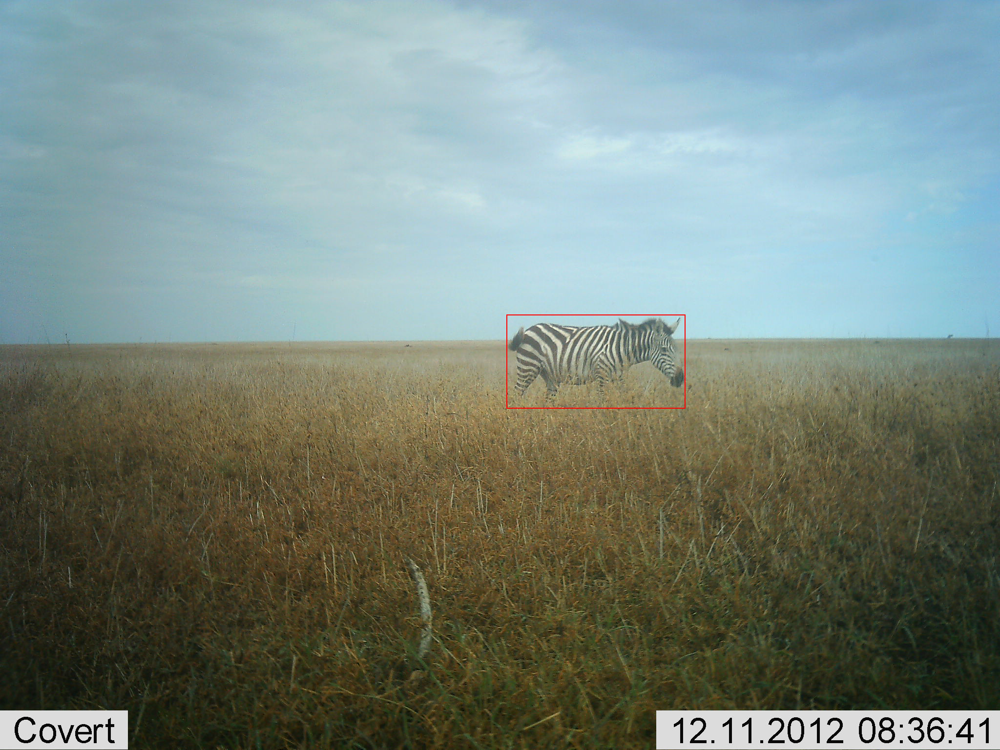

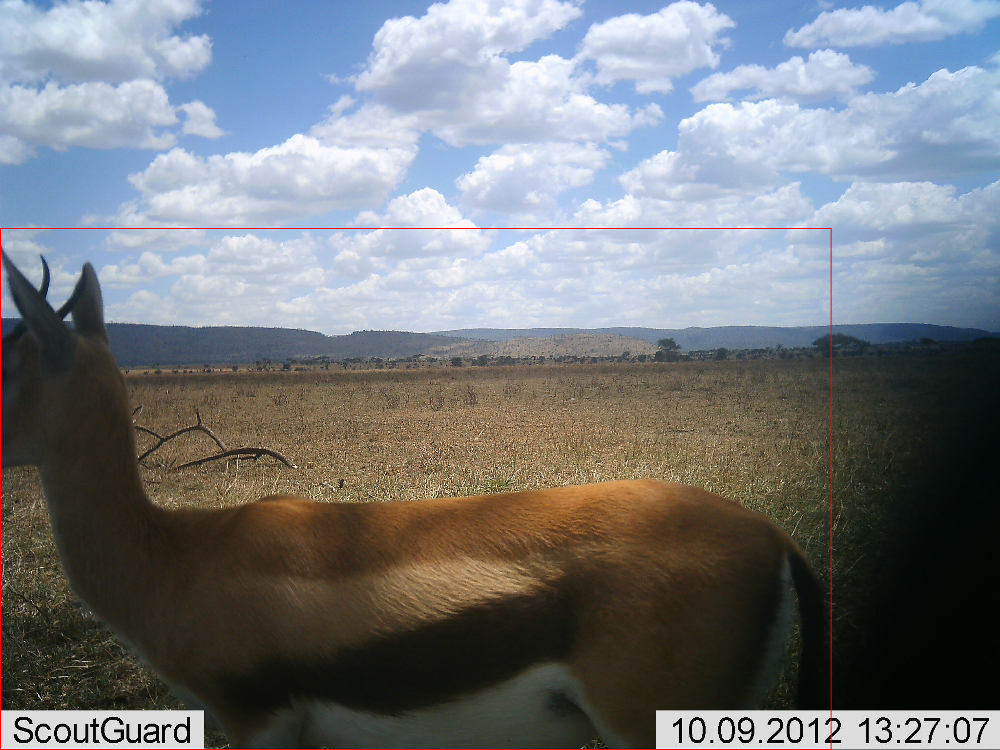

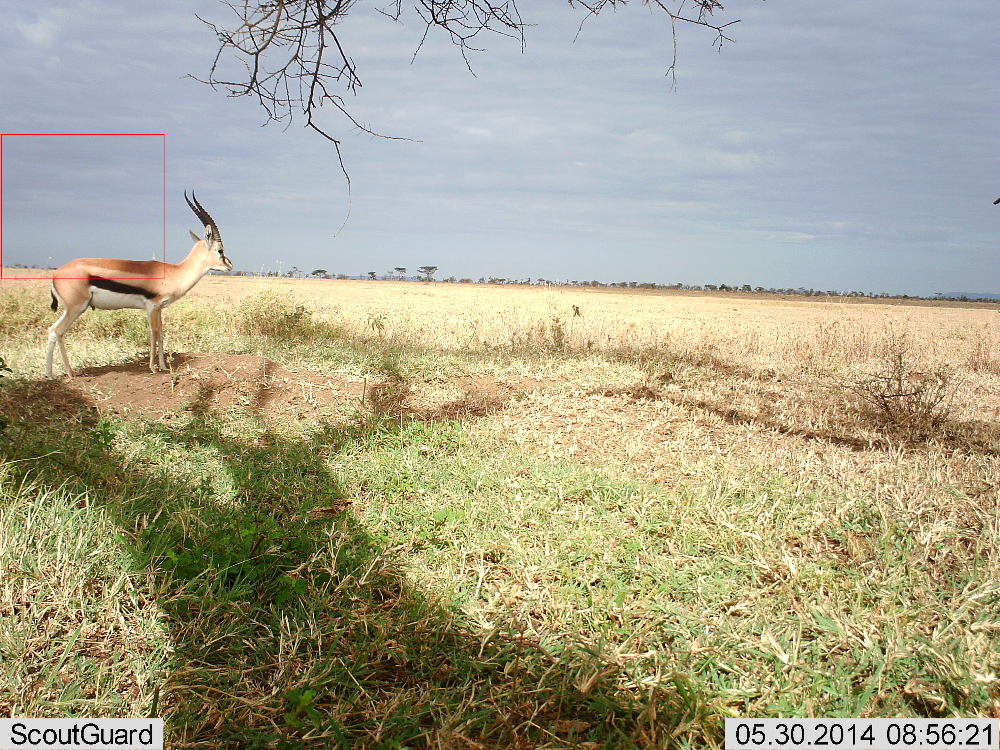

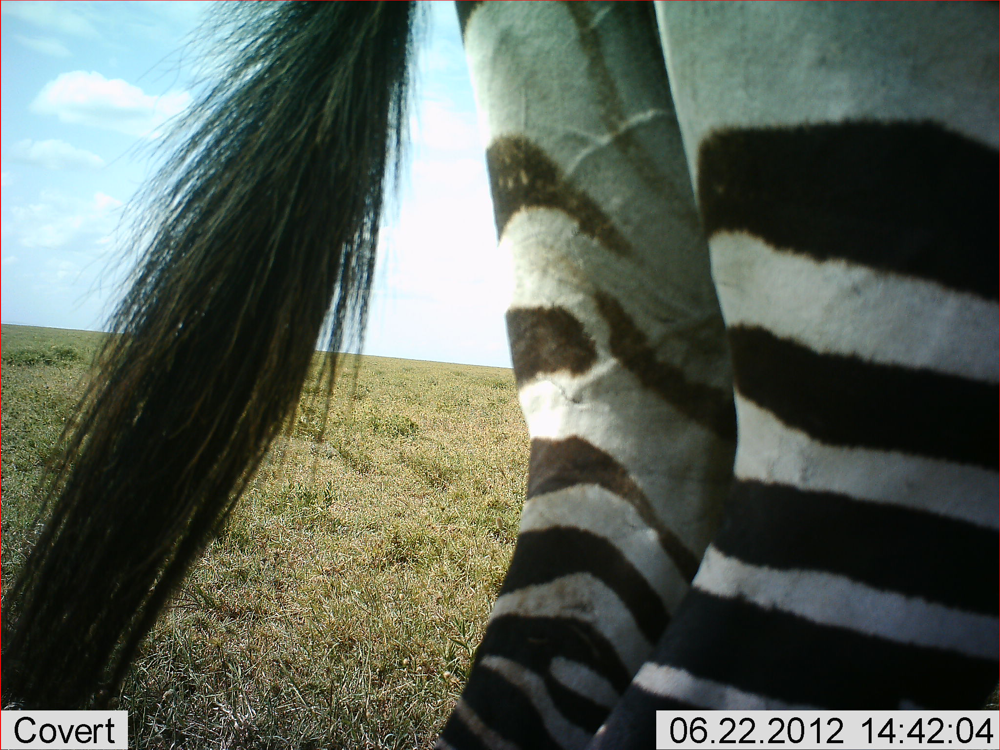

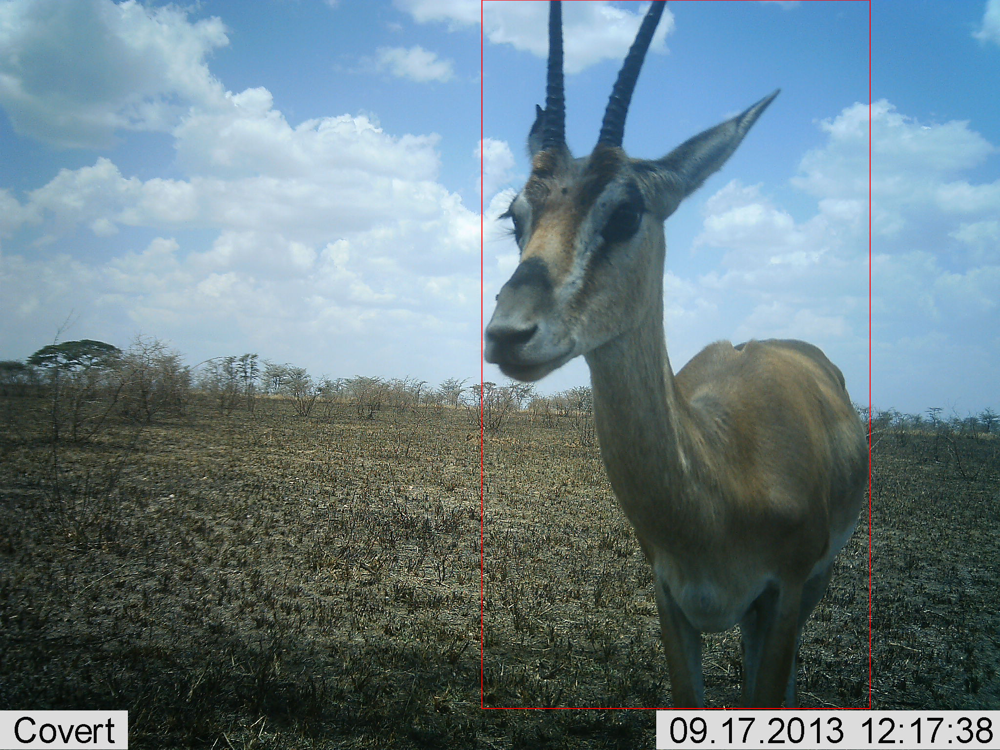

In [55]:
# ***** Show sample images and bounding boxes ******
for _ in range(5):
    record = next(iter_record)
    image_path, bboxes = record["image_path"].decode("utf-8"), record["image_bboxes"].decode("utf-8")
    im_width, im_height = record["width"], record["height"]

    ss_entry_pt = "https://lilawildlife.blob.core.windows.net/lila-wildlife/snapshotserengeti-unzipped/"
    url = os.path.join(ss_entry_pt, image_path)

    # Download the image
    print(f"\n\nDownloading {url}...")
    response = requests.get(url)
    image = Image.open(io.BytesIO(response.content))
    draw = ImageDraw.Draw(image)

    # COCO uses the XYWH format. PIL uses the XYXY format.
    bboxes = ast.literal_eval(str(bboxes))
    for bbox in bboxes:
        x1, y1, w, h = bbox
        xmin, xmax, ymin, ymax = x1, x1 + w, y1, y1 + h

        left = xmin * im_width
        right = xmax * im_width
        top = ymin * im_height
        bottom = ymax * im_height

        draw.line(
            [
                (left, top), (left, bottom), (right, bottom),
                (right, top), (left, top)
            ], 
            fill=(255, 0, 0), 
            width=2
        )
    display(image)